<a href="https://colab.research.google.com/github/visualdatabase/fastdup/blob/main/examples/fastdup_tensorboard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fastdup Tutorial

[Visit our GitHub Project Page](https://github.com/visualdatabase/fastdup)

## Install fastdup

In [4]:
!pip install -U --force-reinstall fastdup

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 49.9 MB 59 kB/s 
     |████████████████████████████████| 15.7 MB 39.7 MB/s 
     |████████████████████████████████| 11.3 MB 32.5 MB/s 
     |████████████████████████████████| 60.9 MB 110 kB/s 
     |████████████████████████████████| 78 kB 6.3 MB/s 
     |████████████████████████████████| 596 kB 60.7 MB/s 
     |████████████████████████████████| 247 kB 58.4 MB/s 
     |████████████████████████████████| 500 kB 49.8 MB/s 
  Attempting uninstall: six
    Found existing installation: six 1.15.0
    Uninstalling six-1.15.0:
      Successfully uninstalled six-1.15.0
  Attempting uninstall: pytz
    Found existing installation: pytz 2022.2.1
    Uninstalling pytz-2022.2.1:
      Successfully uninstalled pytz-2022.2.1
  Attempting uninstall: python-dateutil
    Found existing installation: python-dateutil 2.8.2
    Uninstalling python-dateutil-2.8.2:
      S

In [1]:
import fastdup

In [2]:
fastdup.__version__

'0.141'

## Download the food-101 dataset

Note that this dataset contains 101,000 images, we can run fully analyze it with fastdup on a weak Colab free notebook in about 10 minutes using a single core, without a GPU! If you like to speed up the execution you should switch to a stronger machine.

In [4]:
!wget http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz

--2022-09-17 04:43:10--  http://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/food-101.tar.gz [following]
--2022-09-17 04:43:10--  https://data.vision.ee.ethz.ch/cvl/food-101.tar.gz
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4996278331 (4.7G) [application/x-gzip]
Saving to: ‘food-101.tar.gz’

food-101.tar.gz     100%[===================>]   4.65G  18.6MB/s    in 4m 28s  

2022-09-17 04:47:39 (17.8 MB/s) - ‘food-101.tar.gz’ saved [4996278331/4996278331]



In [5]:
!tar xzf food-101.tar.gz

## Run fastdup to gain insights from your data
### This may take around 30 minutes on a single core colab notebook and around 1 minute using 32 core machine. (Dataset size is 101,000 images).

In [4]:
%pip install wurlitzer
%load_ext wurlitzer

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
!rm -fr out
# run fastdup, on 10K images, and use connected components threshold 0.9 namely only images with cosine similarity larger
# then 0.9 are included in the component.
fastdup.run('food-101', work_dir='out', num_images=10000,turi_param='ccthreshold=0.9')

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
Going to loop over dir food-101
Found total 10000 images to run on
Wrote total of 10000 features , found 0 bad images
Found total 10000 images to run on
13292) Finished write_index() NN model
Stored nn model index file out/nnf.index
1663392873 : INFO:     (add_vertices:460): Num vertices for group 0: 10000
1663392873 : INFO:     (commit_edge_buffer:609): In commit edge buffer (0,0)
1663392873 : INFO:     (commit_edge_buffer:680): Shuffling edges ...
1663392873 : INFO:     (commit_edge_buffer:688): Done shuffling edges in 0.021324 secs
1663392873 : INFO:     (commit_edge_buffer:692): Aggregating unique vertices...
1663392873 : INFO:     (commit_edge_buffer:705): Done aggregating unique vertex in 0.012376 secs
1663392873 : INFO:     (commit_edge_buffer:713): Combine vertex data
1663392873 : INFO:     (commit_edge_buffer:779): Done phase 2 in 0.008761 secs
1663392873 : INFO:     (commit_edge_buffer:787): Rename id 

0

Wrote total of 10000 components 
Total time took 309448 ms
Found a total of 24 fully identical images (d>0.990), which are 0.08 %
Found a total of 20 nearly identical images(d>0.980), which are 0.07 %
Found a total of 201 above threshold images (d>0.900), which are 0.67 %
Found a total of 1000 outlier images         (d<0.050), which are 3.33 %
Min distance found 0.106 max distance 1.000


In [4]:
# example filename food-101/images/peking_duck/388951.jpg
# the label is the folder name peking_duck
def my_label(path):
  return path.split('/')[-2]

In [20]:
fastdup.create_duplicates_gallery('out',save_path='.', num_images=10, max_width=400, get_label_func=my_label)

100%|██████████| 10/10 [00:00<00:00, 18.90it/s]


Stored similarity visual view in  ./similarity.html


0

,Image,Distance,From,To
0,,1.0,food-101/images/breakfast_burrito/662420.jpgLabel: breakfast_burrito,food-101/images/breakfast_burrito/662424.jpgLabel: breakfast_burrito
1,,1.0,food-101/images/breakfast_burrito/662424.jpgLabel: breakfast_burrito,food-101/images/breakfast_burrito/662423.jpgLabel: breakfast_burrito
2,,1.0,food-101/images/baby_back_ribs/620996.jpgLabel: baby_back_ribs,food-101/images/baby_back_ribs/620997.jpgLabel: baby_back_ribs
4,,1.0,food-101/images/beignets/1996069.jpgLabel: beignets,food-101/images/beignets/1997437.jpgLabel: beignets
5,,1.0,food-101/images/breakfast_burrito/662420.jpgLabel: breakfast_burrito,food-101/images/breakfast_burrito/662423.jpgLabel: breakfast_burrito
6,,1.0,food-101/images/beet_salad/2595905.jpgLabel: beet_salad,food-101/images/beet_salad/2671983.jpgLabel: beet_salad
7,,1.0,food-101/images/baby_back_ribs/3124916.jpgLabel: baby_back_ribs,food-101/images/baby_back_ribs/3125728.jpgLabel: baby_back_ribs
8,,1.0,food-101/images/apple_pie/1461580.jpgLabel: apple_pie,food-101/images/apple_pie/1469191.jpgLabel: apple_pie
9,,1.0,food-101/images/beef_carpaccio/1769984.jpgLabel: beef_carpaccio,food-101/images/beef_carpaccio/1801501.jpgLabel: beef_carpaccio

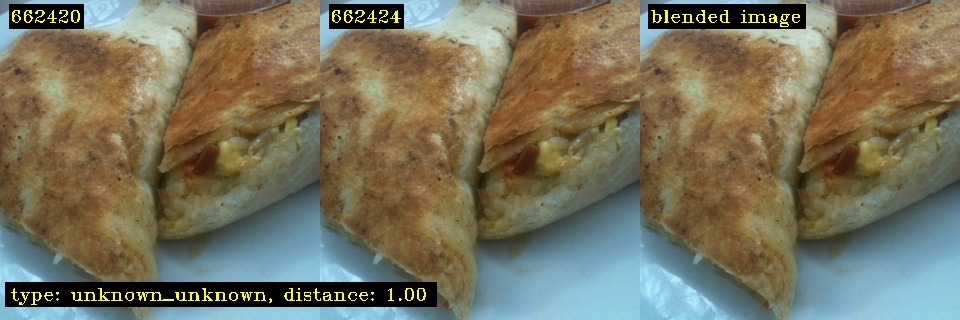
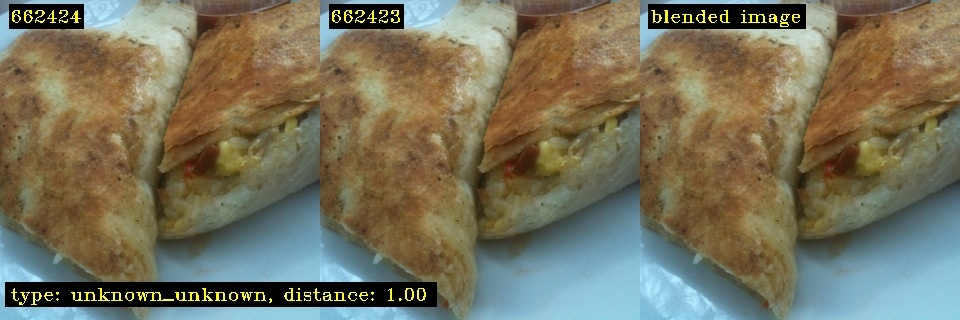
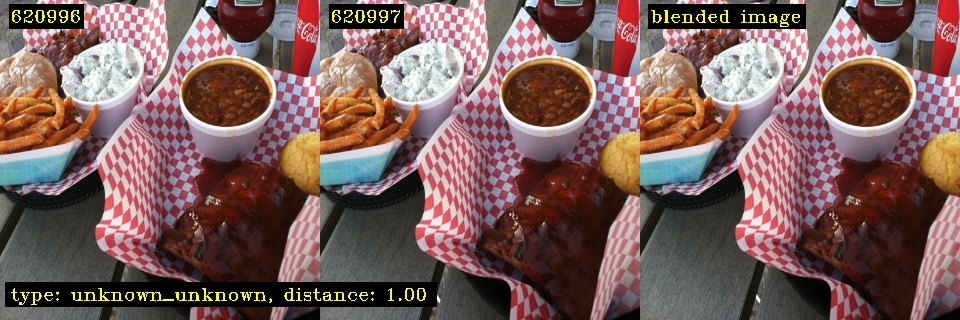
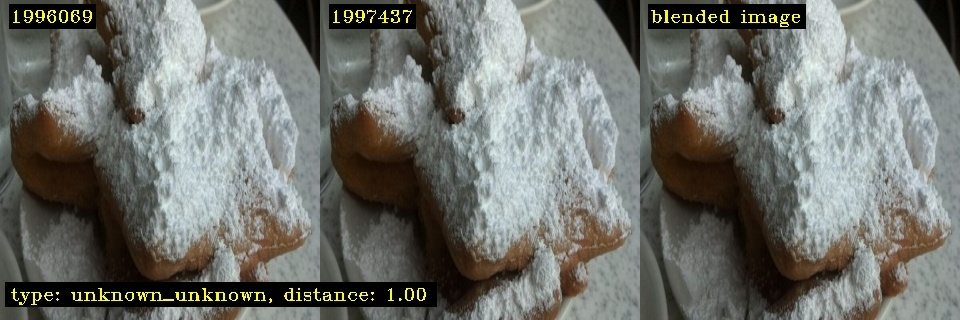
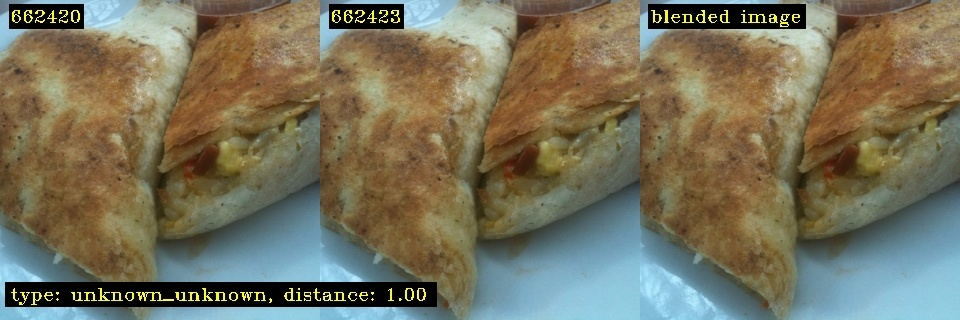
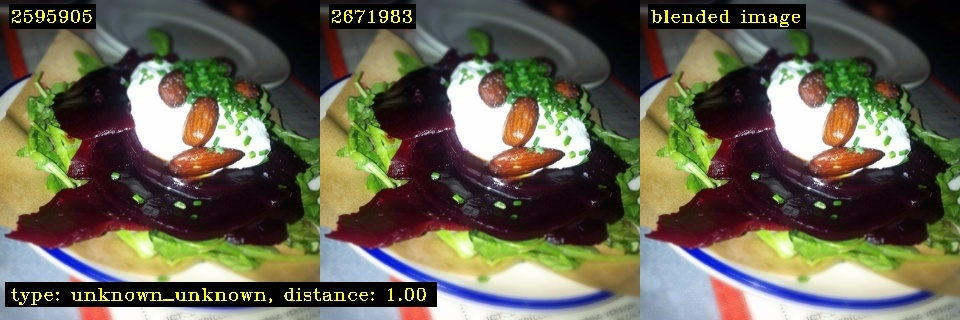
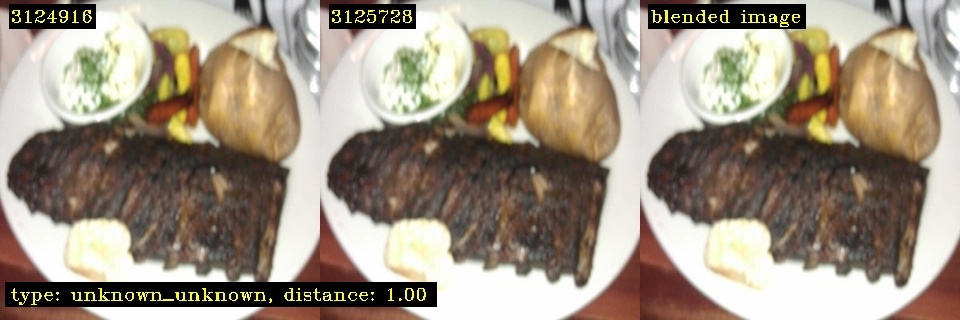
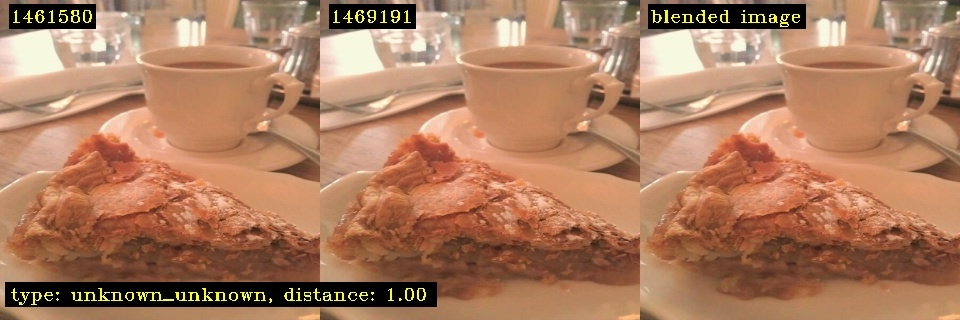
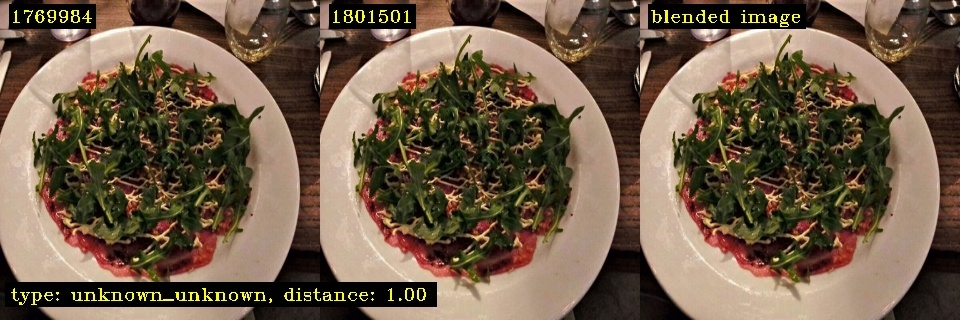

In [8]:
from IPython.display import HTML
HTML('similarity.html')

100%|██████████| 10/10 [00:00<00:00, 196.33it/s]

Stored outliers visual view in  ./outliers.html


,Image,Distance,Path
10099,,0.112211,food-101/images/breakfast_burrito/462294.jpgLabel: breakfast_burrito
10097,,0.428720,food-101/images/macarons/2117640.jpgLabel: macarons
10095,,0.515785,food-101/images/tacos/1505262.jpgLabel: tacos
10094,,0.528563,food-101/images/shrimp_and_grits/1047420.jpgLabel: shrimp_and_grits
10093,,0.546918,food-101/images/sushi/3100962.jpgLabel: sushi
10091,,0.548758,food-101/images/ravioli/1449254.jpgLabel: ravioli
10088,,0.573438,food-101/images/pho/2399877.jpgLabel: pho
10087,,0.573612,food-101/images/prime_rib/587532.jpgLabel: prime_rib
10086,,0.574433,food-101/images/pho/1840846.jpgLabel: pho
10085,,0.576987,food-101/images/chocolate_cake/2518457.jpgLabel: chocolate_cake

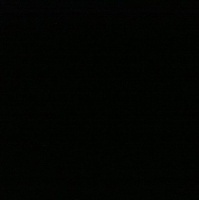
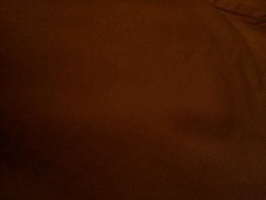
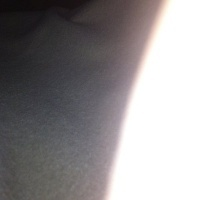
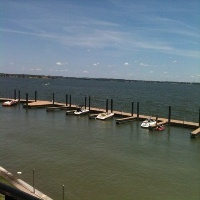
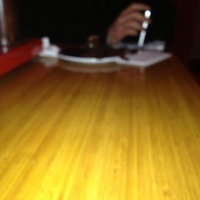
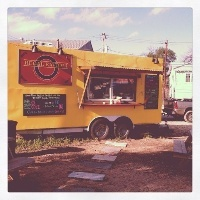
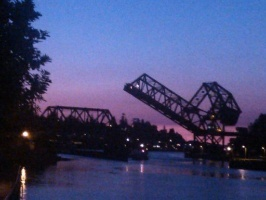
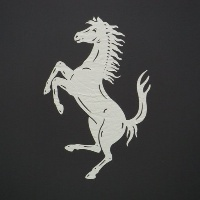
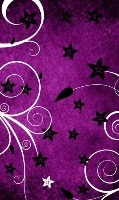
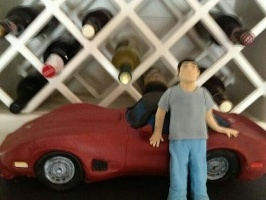

In [9]:
fastdup.create_outliers_gallery('out',save_path='.', num_images=10, max_width=200, get_label_func=my_label)
HTML('outliers.html')

100%|██████████| 20/20 [00:00<00:00, 173.81it/s]

Stored mean statistics view in  ./mean.html



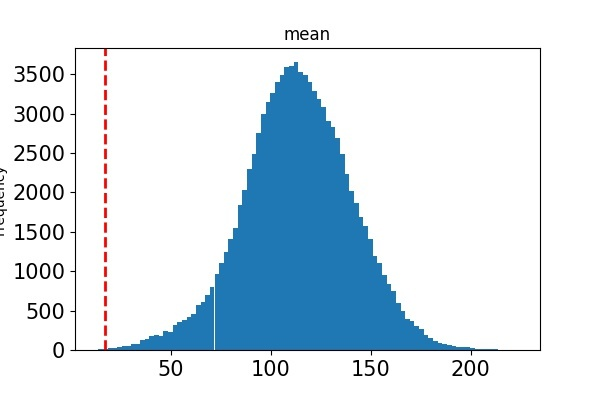
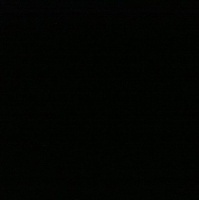
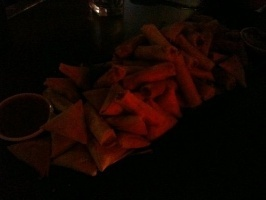
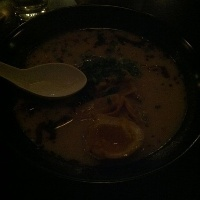
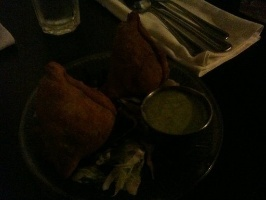
...
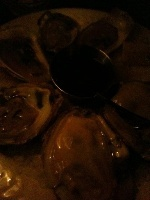
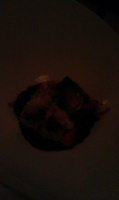
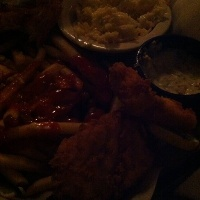
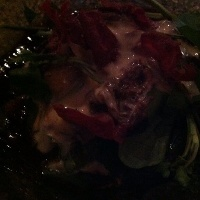

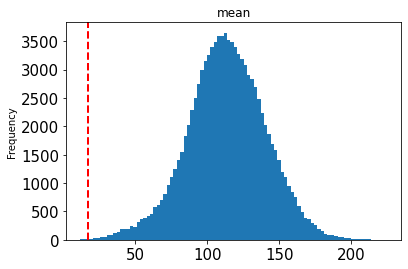

In [10]:
fastdup.create_stats_gallery('out', metric='mean', save_path='.', num_images=20, max_width=200, get_label_func=my_label)
HTML('mean.html')

Saved aspect ratio report to ./aspect_ratio.html



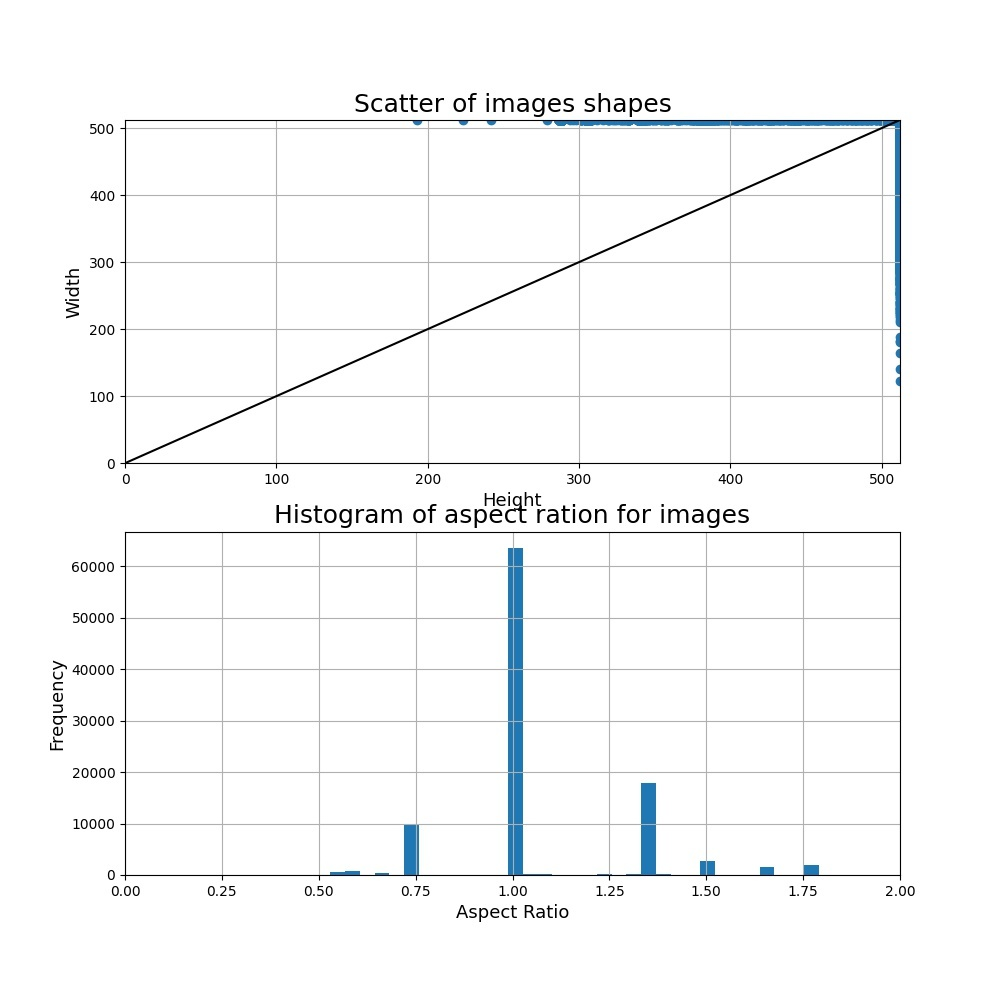
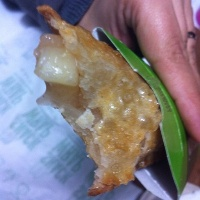
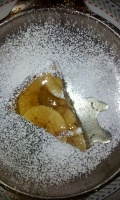

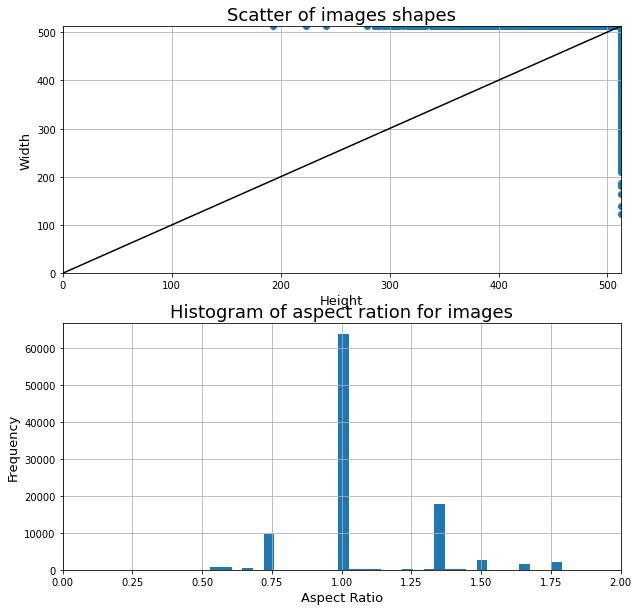

In [11]:
ret = fastdup.create_aspect_ratio_gallery('out', save_path='.', max_width=200, get_label_func=my_label)
HTML('aspect_ratio.html')

## Perform graph analytics to find connected components of images

Connected components are clusters of similar images. In the code below we find the largest clusters of duplicate images and visualize them.

100%|██████████| 20/20 [00:00<00:00, 49.62it/s]


Finished OK. Components are stored as image files ./components_index_id.jpg
Stored components visual view in  ./components.html



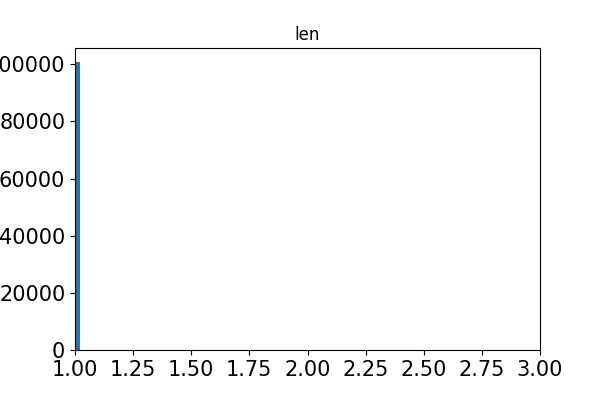
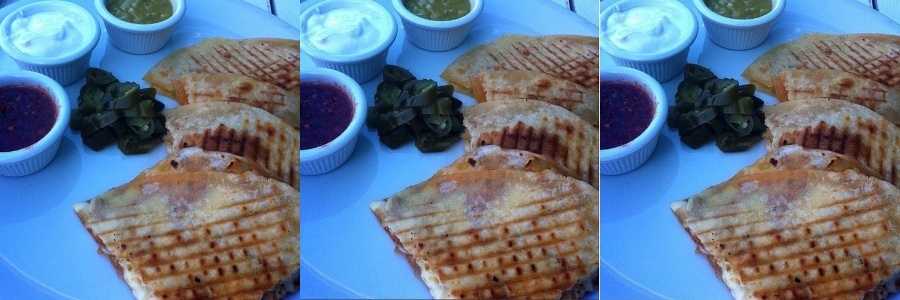
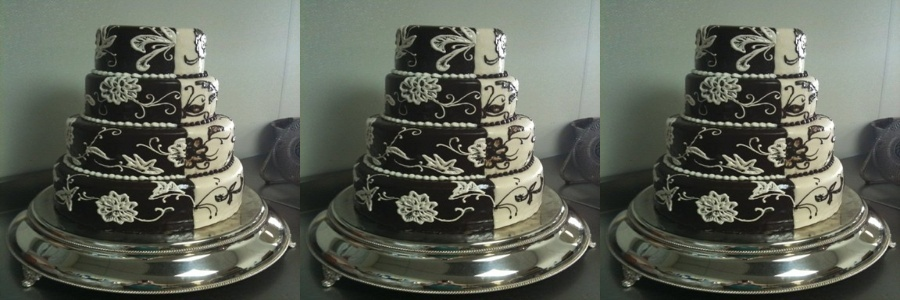
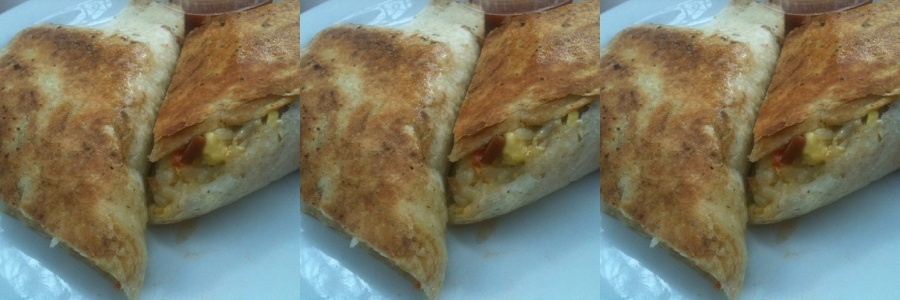
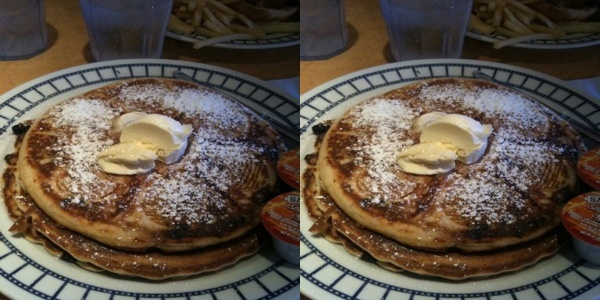
...
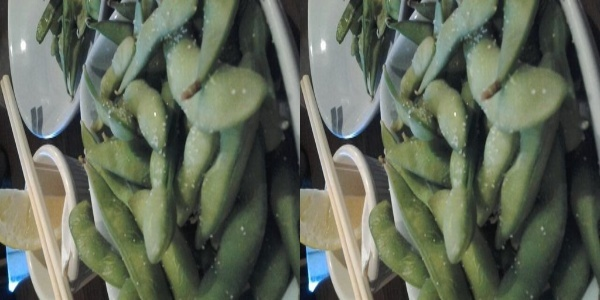
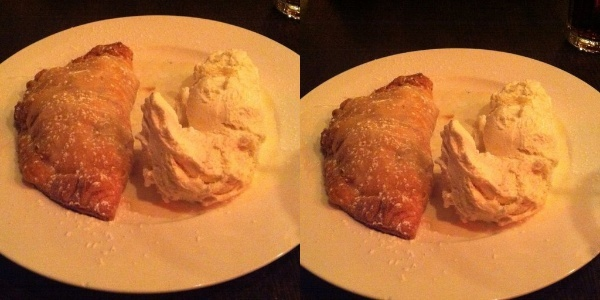
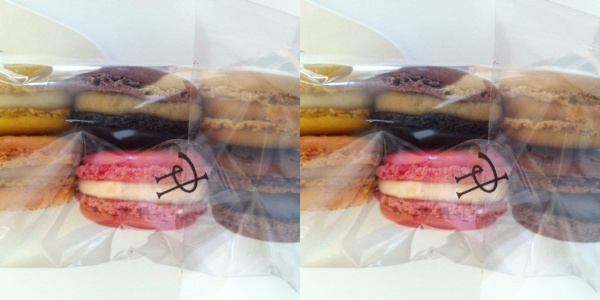
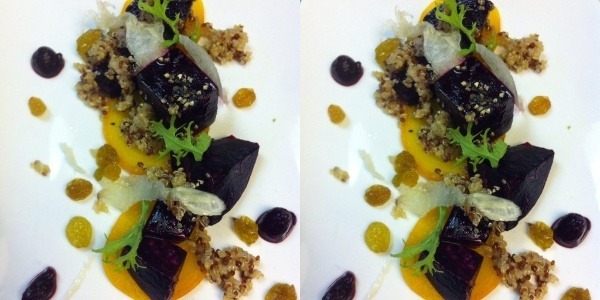

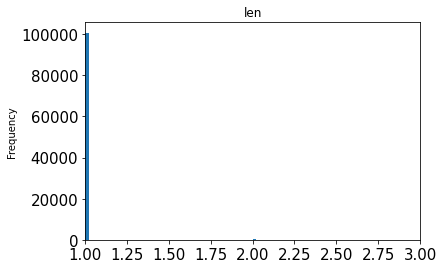

In [12]:
fastdup.create_components_gallery('out','.', max_width=300, get_label_func=my_label)
HTML('./components.html')

# Visualize the results with TensorBoard Projector

In [13]:

fastdup.export_to_tensorboard_projector('out','tmp4',900,get_label_func=my_label)

Read a total of  10000 images


2022-09-17 05:38:38.463337: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected


Finish exporting to tensorboard projector, now run
%load_ext tensorboard
%tensorboard --logdir=tmp4


In [14]:
%load_ext tensorboard


Note: sometimes tensorboard does not boot up on the first call, try to run again in case you see the message "No dashboards are active for the current data set." If that does not work, try to kill tensorboard (look for the !kill command listed when loading tensorboard, and run again).

In [16]:
%tensorboard --logdir=tmp4


Reusing TensorBoard on port 6006 (pid 1254), started 0:00:28 ago. (Use '!kill 1254' to kill it.)

<IPython.core.display.Javascript object>

# Slice the data based on the label. 
## Find outliers for the apple_pie class

In [13]:
#provide the function which assigns the label using get_label_func argument
fastdup.create_outliers_gallery('out',save_path='.', num_images=10, get_label_func=my_label, slice='apple_pie', max_width=200)

100%|██████████| 10/10 [00:00<00:00, 45.79it/s]


Stored outliers visual view in  ./outliers.html


In [14]:
## Find outliers with apple_pie title

,Image,Distance,Path
10044,,0.636369,food-101/images/apple_pie/484038.jpgLabel: apple_pie
10042,,0.639198,food-101/images/apple_pie/236966.jpgLabel: apple_pie
9968,,0.662329,food-101/images/apple_pie/2008772.jpgLabel: apple_pie
9336,,0.706443,food-101/images/apple_pie/2110106.jpgLabel: apple_pie
9305,,0.707248,food-101/images/apple_pie/245712.jpgLabel: apple_pie
9303,,0.707357,food-101/images/apple_pie/3108401.jpgLabel: apple_pie
9155,,0.711518,food-101/images/apple_pie/532972.jpgLabel: apple_pie
9073,,0.713268,food-101/images/apple_pie/2782050.jpgLabel: apple_pie
8808,,0.719574,food-101/images/apple_pie/2298862.jpgLabel: apple_pie
8759,,0.720401,food-101/images/apple_pie/1191665.jpgLabel: apple_pie

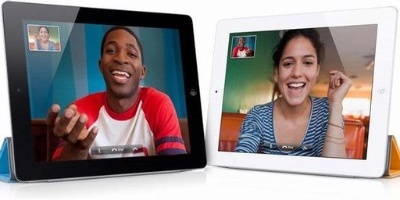
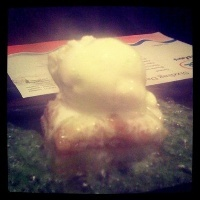
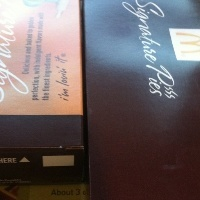
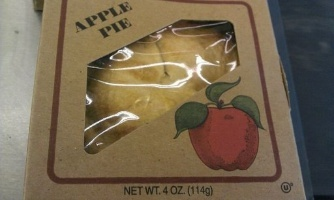
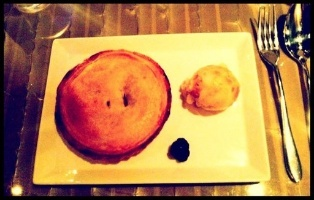
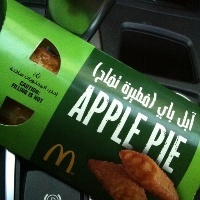
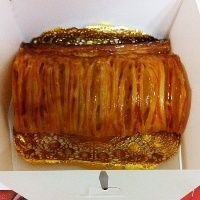
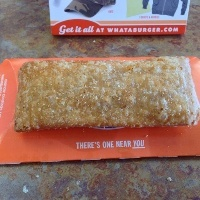
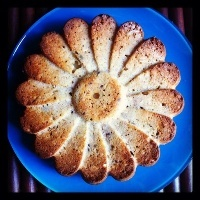
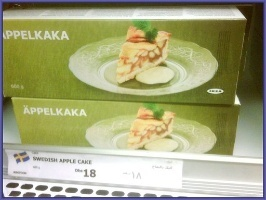

In [15]:
HTML('./outliers.html')